# Milestone 2 Phase 2

**Name: Prabaningrum Hendraswari B.**

**Batch: 001-HCK**

In [1]:
#Import Libraries
import os
import glob
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from PIL import Image

import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping,ModelCheckpoint

from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Dropout, Flatten, Activation

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score,classification_report,ConfusionMatrixDisplay,confusion_matrix, roc_auc_score, roc_curve,precision_score, recall_score, f1_score
import warnings
warnings.filterwarnings('ignore')

## Data Background

In this analysis, we have a data from [Kaggle](https://www.kaggle.com/datasets/ashishjangra27/face-mask-12k-images-dataset) where there are 12000 images that are scraped from the internet by [Jessica Li](https://www.kaggle.com/jessicali9530) which contains various images of people wearing a face mask, and not wearing a face mask. The necessity of the use of this data might come from how wearing masks is scientifically proven to be one of the effective preventable measures for COVID-19, and since we are still living at a time where the pandemic is not entirely under control yet, it might be beneficial **to be able to make a model that can recognize whether a person is wearing a mask or not**. And thus, the purpose of this analysis and model construction is exactly that.

## Data Loading

In [2]:
#Checking directory
os.listdir('Images')

['Inference', 'Test', 'Train', 'Validation']

In [3]:
#Inputting path
main_path= 'Images/'

In [4]:
main_path

'Images/'

In [5]:
#Assigning each directory to the splitting of the data
train_dir = os.path.join(main_path, 'Train')
val_dir = os.path.join(main_path, 'Validation')
test_dir = os.path.join(main_path, 'Test')

In [6]:
train_dir

'Images/Train'

In [7]:
#Checking the numbers of each category in each data group
print('train set: \n' + '='*50)
num_mask= len(os.listdir(os.path.join(train_dir, 'WithMask')))
num_nomask= len(os.listdir(os.path.join(train_dir, 'WithoutMask')))
print(f'Numer of Masked= {num_mask}')
print(f'Number of Without Mask= {num_nomask}')

train set: 
Numer of Masked= 5000
Number of Without Mask= 5000


In [8]:
print('val set: \n' + '='*50)
num_mask1= len(os.listdir(os.path.join(val_dir, 'WithMask')))
num_nomask1= len(os.listdir(os.path.join(val_dir, 'WithoutMask')))
print(f'Numer of Masked= {num_mask1}')
print(f'Number of Without Mask= {num_nomask1}')

val set: 
Numer of Masked= 400
Number of Without Mask= 400


In [9]:
print('test set: \n' + '='*50)
num_mask2= len(os.listdir(os.path.join(test_dir, 'WithMask')))
num_nomask2= len(os.listdir(os.path.join(test_dir, 'WithoutMask')))
print(f'Numer of Masked= {num_mask2}')
print(f'Number of Without Mask= {num_nomask2}')

test set: 
Numer of Masked= 483
Number of Without Mask= 509


In [10]:
df = {"image_path":[],"mask_status":[],"where":[]}
for where in os.listdir(main_path):
    for status in os.listdir(main_path+"/"+where):
        for image in glob.glob(main_path+where+"/"+status+"/"+"*.png"):
            df["image_path"].append(image)
            df["mask_status"].append(status)
            df["where"].append(where)
df = pd.DataFrame(df)
df

,image_path,mask_status,where
0,Images/Test/WithMask\1163.png,WithMask,Test
1,Images/Test/WithMask\1174.png,WithMask,Test
2,Images/Test/WithMask\1175.png,WithMask,Test
3,Images/Test/WithMask\1203.png,WithMask,Test
4,Images/Test/WithMask\1361.png,WithMask,Test
...,...,...,...
11787,Images/Validation/WithoutMask\965.png,WithoutMask,Validation
11788,Images/Validation/WithoutMask\97.png,WithoutMask,Validation
11789,Images/Validation/WithoutMask\970.png,WithoutMask,Validation
11790,Images/Validation/WithoutMask\971.png,WithoutMask,Validation


## EDA

With Mask: 5883,
Without Mask: 5909



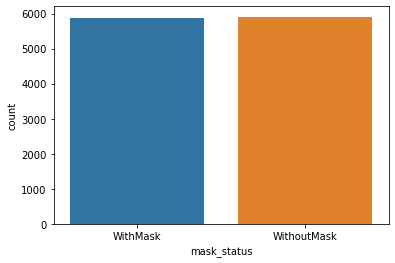

In [11]:
masked = df.value_counts("mask_status")[1]
withoutmask = df.value_counts("mask_status")[0]
#Count number of people with mask and without mask
print(f"With Mask: {masked},\nWithout Mask: {withoutmask}\n")
sns.countplot(df["mask_status"])
plt.show()

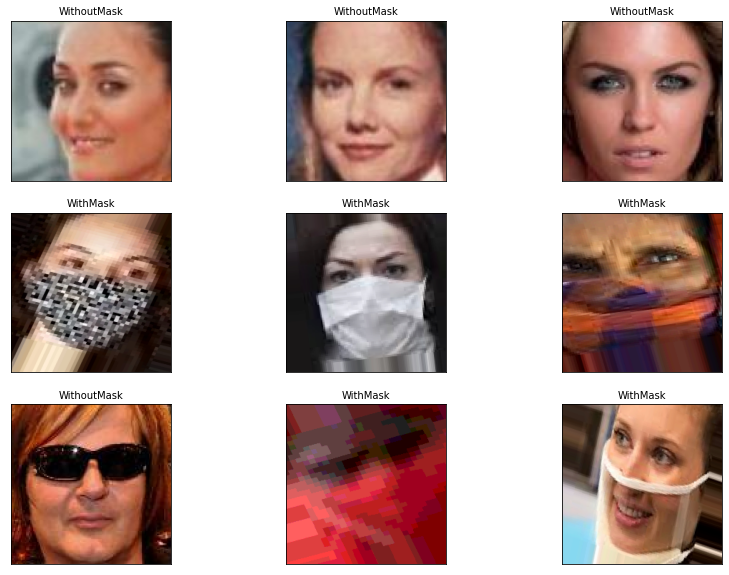

In [12]:
#plot to show random picture of image in file
plt.figure(figsize = (14,10))
for i in range(9):
    random = np.random.randint(1,len(df))
    plt.subplot(3,3,i+1)
    plt.imshow(load_img(df.loc[random,"image_path"]))
    plt.title(df.loc[random, "mask_status"], size = 10) 
    plt.xticks([])
    plt.yticks([])
    
plt.show()

In [13]:
#splitting the data
train_df = df[df["where"] == "Train"]
test_df = df[df["where"] == "Test"]
val_df = df[df["where"] == "Validation"]

In [14]:
print(train_df.shape)
train_df.head()

(10000, 3)


,image_path,mask_status,where
992,Images/Train/WithMask\10.png,WithMask,Train
993,Images/Train/WithMask\100.png,WithMask,Train
994,Images/Train/WithMask\1004.png,WithMask,Train
995,Images/Train/WithMask\1005.png,WithMask,Train
996,Images/Train/WithMask\1006.png,WithMask,Train


In [15]:
val_df.head()

,image_path,mask_status,where
10992,Images/Validation/WithMask\1002.png,WithMask,Validation
10993,Images/Validation/WithMask\1003.png,WithMask,Validation
10994,Images/Validation/WithMask\1176.png,WithMask,Validation
10995,Images/Validation/WithMask\1189.png,WithMask,Validation
10996,Images/Validation/WithMask\1204.png,WithMask,Validation


In [16]:
test_df.head()

,image_path,mask_status,where
0,Images/Test/WithMask\1163.png,WithMask,Test
1,Images/Test/WithMask\1174.png,WithMask,Test
2,Images/Test/WithMask\1175.png,WithMask,Test
3,Images/Test/WithMask\1203.png,WithMask,Test
4,Images/Test/WithMask\1361.png,WithMask,Test


From the exploratory data analysis, we are able to know that the images that are saved in .png format are separated into 3 groups which are for train, test, and val, and within that group the images are already separated into those who are wearing a mask and those who are not wearing a mask. We have a total of 5883 images of people with masks and 5909 images of people without masks which are pretty balanced and will make it easier for the model to predict. 

It can also be inferred that there are almost no negative space within the images between the outline of the face and the image border. Therefore, it could be beneficial if we put in some padding within the model later on.

## Data Augmentation

In [17]:
def train_val_generators (train_dir, val_dir,test_dir):
	train_datagen = ImageDataGenerator(rescale=1./255,rotation_range=0.1,
									width_shift_range=0.2,
									height_shift_range=0.2,
									shear_range=0.2,
									zoom_range=0.2,
									horizontal_flip=True)
	train_generator = train_datagen.flow_from_directory(directory=train_dir,batch_size=32, class_mode='binary',target_size=(150,150))

	validation_datagen = ImageDataGenerator(rescale=1./255)
	validation_generator = validation_datagen.flow_from_directory(directory=val_dir,batch_size=32, class_mode='binary',target_size=(150,150))

	test_datagen = ImageDataGenerator(rescale=1./255)
	test_generator = test_datagen.flow_from_directory(directory=test_dir,batch_size=32, class_mode='binary',target_size=(150,150))

	return train_generator, validation_generator, test_generator

In the train data, we are doing various augmentations towards the images contained in it so that the model can leaarn better about the patterns that might mark someone as masked and not masked. This is because presummably, if the images that train the data are more varied, the model could learn a wider range of possibilities about the patterns that are significant to mark whether a person is masked or not.

In [18]:
train_gen,val_gen,test_gen = train_val_generators(train_dir,val_dir,test_dir)

Found 10000 images belonging to 2 classes.
Found 800 images belonging to 2 classes.
Found 992 images belonging to 2 classes.


In [19]:
train_gen.class_indices

{'WithMask': 0, 'WithoutMask': 1}

In [20]:
val_gen.class_indices

{'WithMask': 0, 'WithoutMask': 1}

In [21]:
test_gen.class_indices

{'WithMask': 0, 'WithoutMask': 1}

## Modeling

In [22]:
img_height= 150
img_width= 150
SEED = 101
BATCH =64

In [23]:
callbacks1 = [ 
    EarlyStopping(monitor = 'val_loss', patience = 3), 
    ModelCheckpoint('model_best.hdf5', monitor='val_loss', save_best_only=True)]

In [24]:
inputs= [img_height,img_width,3]

In [25]:
model_seq= Sequential()

#Conv 1
model_seq.add(Conv2D(filters=16, kernel_size=3, 
                            activation= 'relu', input_shape= inputs
                            ))
model_seq.add(MaxPooling2D(pool_size=2, strides=2))

#Conv 2
model_seq.add(Conv2D(filters=32, kernel_size=3, 
                            activation= 'relu',
                            padding='same'
                            ))
model_seq.add(MaxPooling2D(pool_size=2, strides=2, 
                                  padding='same'
                                  ))

#Conv 3
model_seq.add(Conv2D(filters=64, kernel_size=3, activation= 'relu'))
model_seq.add(MaxPooling2D(pool_size=2, strides=2))


model_seq.add(Flatten())
model_seq.add(Dense(units= 128, activation='relu'))
model_seq.add(Dense(units=1, activation='sigmoid'))

model_seq.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 74, 74, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 74, 74, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 37, 37, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 35, 35, 64)        18496     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 17, 17, 64)       0

In [26]:
model_seq.compile(optimizer='adam', loss='binary_crossentropy', metrics= ['accuracy'])

In [27]:
history_seq = model_seq.fit(train_gen, batch_size= BATCH, 
                           epochs= 20, validation_data= val_gen,
                           callbacks= callbacks1)

Epoch 1/20
313/313 [==============================] - 596s 2s/step - loss: 0.2588 - accuracy: 0.8981 - val_loss: 0.1224 - val_accuracy: 0.9613
Epoch 2/20
313/313 [==============================] - 145s 464ms/step - loss: 0.1540 - accuracy: 0.9448 - val_loss: 0.1154 - val_accuracy: 0.9613
Epoch 3/20
313/313 [==============================] - 145s 464ms/step - loss: 0.1354 - accuracy: 0.9519 - val_loss: 0.0918 - val_accuracy: 0.9750
Epoch 4/20
313/313 [==============================] - 145s 464ms/step - loss: 0.1150 - accuracy: 0.9577 - val_loss: 0.0856 - val_accuracy: 0.9700
Epoch 5/20
313/313 [==============================] - 142s 454ms/step - loss: 0.1081 - accuracy: 0.9639 - val_loss: 0.1276 - val_accuracy: 0.9525
Epoch 6/20
313/313 [==============================] - 145s 463ms/step - loss: 0.1030 - accuracy: 0.9632 - val_loss: 0.0737 - val_accuracy: 0.9775
Epoch 7/20
313/313 [==============================] - 147s 470ms/step - loss: 0.0955 - accuracy: 0.9651 - val_loss: 0.0664 - va

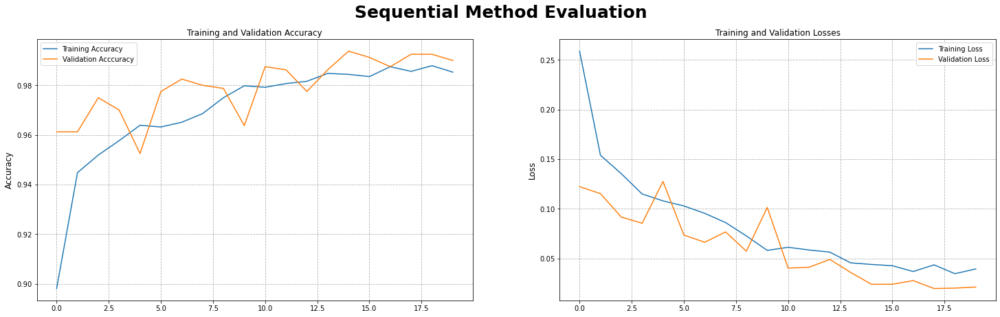

In [28]:
fig, ax = plt.subplots(1,2, figsize=(25,7))
fig.suptitle('Sequential Method Evaluation', fontsize=25, weight='bold')

plt.subplot(1,2,1)
plt.title("Training and Validation Accuracy", fontsize=12)
plt.plot(history_seq.history['accuracy'],label="Training Accuracy")
plt.plot(history_seq.history['val_accuracy'], label="Validation Acccuracy")
plt.ylabel("Accuracy", fontsize=12)
plt.legend()
plt.grid(linestyle='--')

plt.subplot(1,2,2)
plt.title("Training and Validation Losses", fontsize=12)
plt.plot(history_seq.history['loss'], label="Training Loss")
plt.plot(history_seq.history['val_loss'], label="Validation Loss")
plt.ylabel("Loss", fontsize=12)
plt.legend()
plt.grid(linestyle='--')

plt.style.use('default')
plt.show()

For the base model, we are using 3 convolutional layers with filters from 16 to 64, using relu activation and also padding in two of the layers to help with the detection. In this case, we are using adam as its optimizer and the result is that  we have 0.04 train loss, 0.04 val loss, 0.98 train accuracy, and 0.98 val accuracy with the epoch stopping at 14 due to the early stopping. This means that the model is already doing good at predicting the image. However, we will see whether we can improve it or not.

## Model Improvement

In [29]:
model_imp= Sequential()

#Conv 1
model_imp.add(Conv2D(filters=32, kernel_size=3, 
                            activation= 'relu', input_shape= inputs
                            ))
model_imp.add(MaxPooling2D(pool_size=2, strides=2))

#Conv 2
model_imp.add(Conv2D(filters=64, kernel_size=3, 
                            activation= 'relu',
                            padding='same'
                            ))
model_imp.add(MaxPooling2D(pool_size=2, strides=2, 
                                  padding='same'
                                  ))

#Conv 3
model_imp.add(Conv2D(filters=128, kernel_size=3, activation= 'relu'))
model_imp.add(MaxPooling2D(pool_size=2, strides=2))


model_imp.add(Flatten())
model_imp.add(Dense(units= 128, activation='relu'))
model_imp.add(Dense(units=1, activation='sigmoid'))

model_imp.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 74, 74, 32)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 74, 74, 64)        18496     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 37, 37, 64)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 35, 35, 128)       73856     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 17, 17, 128)     

In [31]:
model_imp.compile(optimizer='adam', loss='binary_crossentropy', metrics= ['accuracy'])

In [32]:
history_imp = model_imp.fit(train_gen, batch_size= BATCH, 
                           epochs= 20, validation_data= val_gen,
                           callbacks= callbacks1)

Epoch 1/20
313/313 [==============================] - 81s 258ms/step - loss: 0.2643 - accuracy: 0.8983 - val_loss: 0.1273 - val_accuracy: 0.9625
Epoch 2/20
313/313 [==============================] - 94s 299ms/step - loss: 0.1529 - accuracy: 0.9430 - val_loss: 0.1091 - val_accuracy: 0.9575
Epoch 3/20
313/313 [==============================] - 94s 301ms/step - loss: 0.1282 - accuracy: 0.9528 - val_loss: 0.1003 - val_accuracy: 0.9688
Epoch 4/20
313/313 [==============================] - 95s 302ms/step - loss: 0.1236 - accuracy: 0.9587 - val_loss: 0.0971 - val_accuracy: 0.9712
Epoch 5/20
313/313 [==============================] - 95s 303ms/step - loss: 0.1231 - accuracy: 0.9584 - val_loss: 0.1225 - val_accuracy: 0.9563
Epoch 6/20
313/313 [==============================] - 94s 301ms/step - loss: 0.1057 - accuracy: 0.9626 - val_loss: 0.1034 - val_accuracy: 0.9663
Epoch 7/20
313/313 [==============================] - 95s 302ms/step - loss: 0.1033 - accuracy: 0.9661 - val_loss: 0.0750 - val_ac

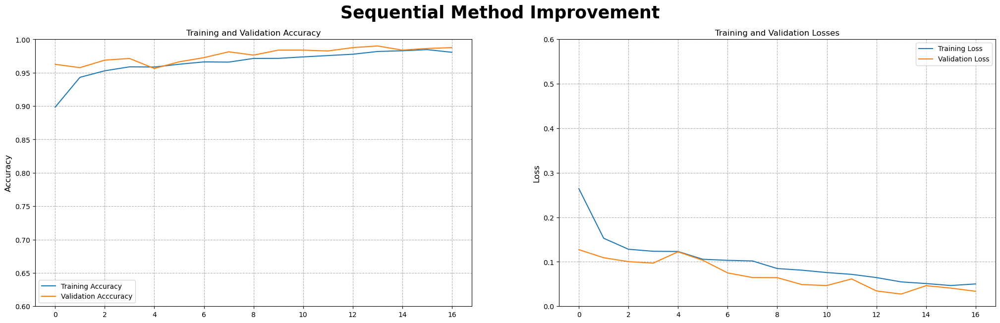

In [33]:
fig, ax = plt.subplots(1,2, figsize=(25,7))
fig.suptitle('Sequential Method Improvement', fontsize=25, weight='bold')

plt.subplot(1,2,1)
plt.title("Training and Validation Accuracy", fontsize=12)
plt.plot(history_imp.history['accuracy'],label="Training Accuracy")
plt.plot(history_imp.history['val_accuracy'], label="Validation Acccuracy")
plt.ylabel("Accuracy", fontsize=12)
plt.legend()
plt.ylim(0.6,1)
plt.grid(linestyle='--')

plt.subplot(1,2,2)
plt.title("Training and Validation Losses", fontsize=12)
plt.plot(history_imp.history['loss'], label="Training Loss")
plt.plot(history_imp.history['val_loss'], label="Validation Loss")
plt.ylabel("Loss", fontsize=12)
plt.legend()
plt.ylim(0,0.6)
plt.grid(linestyle='--')

plt.style.use('default')
plt.show()

For the improvement, the only thing I changed was the filters on the convolutional layer so that the first layer has 32 filters, while the secocnd has 64, and the third has 128. The result shows that we have 0.03 train loss, 0.02 val loss, 0.98 train accuracy, and 0.99 val accuracy.

## Model Saving (for backup)

Since the best model seems to be the improved model, we are going to save it just for backup since we previously already have a model save earlier on.

In [34]:
model_imp.save('model_imp.h5')

## Inference

Inference Image reference: https://images.unsplash.com/photo-1598207951491-255eaf139751?ixlib=rb-1.2.1&ixid=MnwxMjA3fDB8MHxzZWFyY2h8M3x8bWFza2VkJTIwcGVyc29ufGVufDB8fDB8fA%3D%3D&auto=format&fit=crop&w=600&q=60

In [35]:
#Loading the inference image and turning it into an array
img = Image.open('Images\Inference\gayatri-malhotra-EJWaKVPB6iI-unsplash.jpg')
img1 = np.array(img)

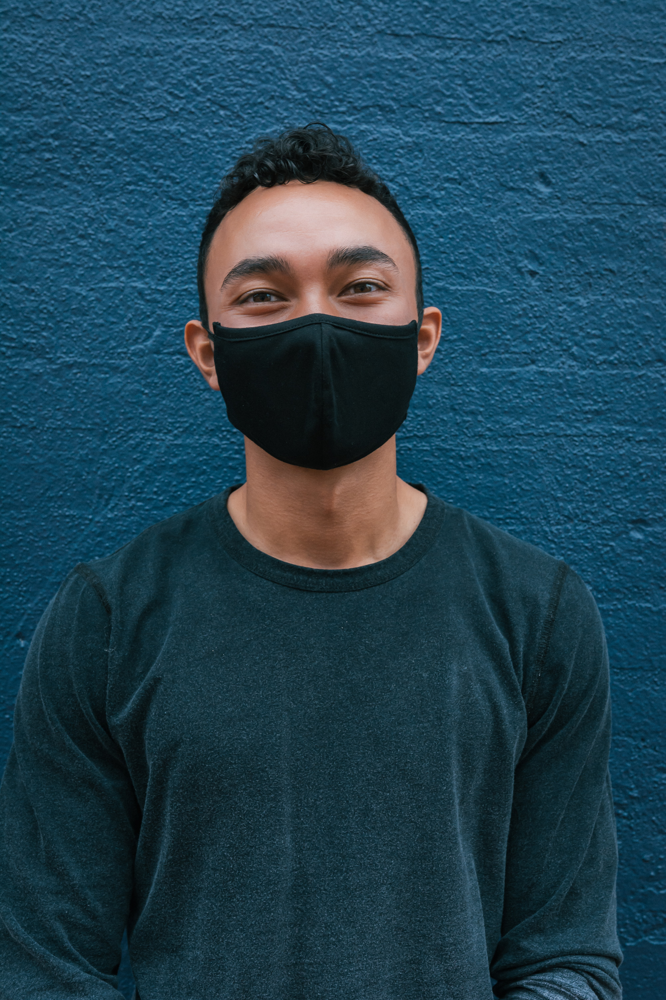

In [36]:
#Showing what the image looks like
img

In [37]:
img_resize = img1/255

In [38]:
img_rescale = cv2.resize(img_resize, (150,150))


In [39]:
img_rescale.shape

(150, 150, 3)

In [40]:
inf = model_imp.predict(np.array([img_rescale]))
np.argmax(inf)

1/1 [==============================] - 0s 221ms/step


0

The inference shows the model correctly predicting the image as masked.

## Conclusion

From the dataset itself, there were initially 3 files which already separates the images for train, validation and test although eventualy the test images were not to be used. Within those files, the images get separated again as to which images are of people who are masked and which images are of people who are not masked. In total, the amount of images between the people who are masked and not masked are pretty even.

From the comparation of the models, it seems that the best model is the one after improvement since if we look at the scores and the graph, overall the improved model does better as it has lower loss score and slightly higher accuracy score. The inference also shows the model correctly predicting the image as a person who is masked (since label 0 is for 'masked').

**changes**

try out with a smaller resolution where 150 x 150 and it's only cropped to the subject's face